<left>
<table style="margin-top:0px; margin-left:0px;">
<tr>
  <td><img src="https://raw.githubusercontent.com/worm-portal/WORM-Figures/master/style/worm.png" alt="WORM" title="WORM" width=50/></td>
  <td><h1 style=font-size:30px>Activity Diagrams Part 2</h1><br />
</tr>
</table>
</left>

### What's covered in this demo?

- How to choose basis species
- Changing log activities of basis species
- Retrieving species of a chosen elemental composition with `retrieve`
- Plotting ion activities on axes (e.g., log activity of Cl<sup>-</sup> on an axis) using Python dictionaries

### Getting ready

Just like in Part 1 of the Activity Diagram demo, we will import the pyCHNOSZ Python package and the [WORM thermodynamic database](https://worm-portal.asu.edu/docs/database/).

In [1]:
from pychnosz import *
_ = thermo("WORM")

reset: thermodynamic system initialized
The WORM thermodynamic database has been loaded: 1713 aqueous, 1976 total species


Let's create activity diagrams featuring aqueous zinc species. We'll start off simply, then get more complicated as we go along.

Since we're interested in zinc species, we need to make sure our basis species set includes zinc. Let's make a minimal basis species that lets us explore the effects of pH. Therefore, we'll need H<sup>+</sup> and H<sub>2</sub>O. Let's tally what we have:

- Zn+2 will represent Zn and charge ("Z").
- H+ will represent H and Z.
- H2O will represent H and O.

A basis species set needs to be able to create a "square stoichiometric matrix". That means there needs to be the same number of basis species as there are elements and charge. In our case, we have:

- Four elements and charge: Zn, O, H, Z
- Three basis species: Zn+2, H+, H2O

So our basis set is not complete yet. If we try to input our list of three basis species into `basis`, we will be greeted by an error:

```
basis(["Zn+2", "H2O", "H+"])

RRuntimeError: Error in put.basis(ispecies, logact) : 
  the number of basis species is less than the number of elements and charge
```

The error tells us that we have too few basis species. We need four basis species to correspond to our four elements and charge. Let's add O<sub>2(g)</sub> to our set so we have four basis species:

In [2]:
basis(["Zn+2", "H2O", "H+", "O2(g)"])

info_character: found H2O(liq) [water]; also available in gas


,H,O,Z,Zn,ispecies,logact,state
Zn+2,0.0,0.0,2.0,1.0,633,0.0,aq
H2O,2.0,1.0,0.0,0.0,1,0.0,liq
H+,1.0,0.0,1.0,0.0,2,0.0,aq
O2,0.0,2.0,0.0,0.0,861,0.0,gas


The resulting table shows how many of each element are in each of the basis species. Note that it is a "square stoichiometric matrix", as required by `basis`. The number of basis species (4) is the same as the number of elements and Z (4)

The table also has a column for `ispecies`, the index of the species in the WORM thermodynamic database.

The `logact` column specifies the log activity of the species. Since we defined our own basis set, the log activities of each of these species is set to 0 (activity=1). This demo will show how to change these values later.

Now we need to select our chemical species of interest. These are the species we want to show up on our activity diagram. We can use the `retrieve` function to search the thermodynamic database for aqueous zinc species that can be represented by our basis set. Since the only elements in our basis set are Zn, O, and H we can search for aqueous species containing these elements with:

In [3]:
retrieve("Zn", ["O", "H"], state="aq")

retrieve: updating stoichiometric matrix


Zn+2       633
ZnOH+1     634
ZnO        635
HZnO2-1    636
ZnO2-2     637
dtype: int64

The output of the `retrieve` function is a list of numbers representing the indices of matched chemical species in the thermodynamic database. We can use the `info` function in combination with `retrieve` to see the thermodynamic data:

In [4]:
# retrieve() is nested inside of info()
info(retrieve("Zn", ["O", "H"], state="aq"))

,name,abbrv,formula,state,ref1,ref2,date,model,E_units,G,...,Cp,V,a1,a2,a3,a4,c1,c2,omega,Z
0,Zn+2,Zn+2,Zn+2,aq,SSWS97.5,SH88.1,11/7/1997,HKF,cal,-35200.0,...,-5.33,-24.3,-0.10676,-892.90,6.1282,-24098.0,18.7400,-53700.0,145740.0,2.0
1,ZnOH+,ZnOH+,ZnOH+1,aq,SSWS97.5,NaN,11/14/1997,HKF,cal,-81190.0,...,10.00,-5.3,0.11499,-496.77,7.6896,-25735.0,15.0306,-9975.0,32600.0,1.0
2,ZnO,ZnO,ZnO,aq,SSWS97.5,NaN,11/14/1997,HKF,cal,-67420.0,...,-10.00,-21.9,-0.12418,-1080.72,9.9819,-23321.0,0.0295,-50715.0,-3000.0,0.0
3,HZnO2-,HZnO2-,HZnO2-1,aq,SSWS97.5,NaN,11/14/1997,HKF,cal,-110720.0,...,20.00,-13.4,0.05623,-640.47,8.2588,-25141.0,35.0874,10394.0,186690.0,-1.0
4,ZnO2-2,ZnO2-2,ZnO2-2,aq,SSWS97.5,NaN,11/14/1997,HKF,cal,-93290.0,...,-15.00,-26.4,-0.05559,-913.47,9.3301,-24013.0,32.5837,-60900.0,382160.0,-2.0


The zinc species we get from `retrieve` include Zn+2 and a bunch of zinc hydroxide complexes.

ZnOH+ is the first complex.

ZnO is the second complex. The reason it is not "Zn(OH)2" is because of a [convention in the thermodynamic literature](https://doi.org/10.1016/S0016-7037(96)00339-0) to remove whole water molecules from the properties of hydroxide complexes when possible:

<center>Zn(OH)<sub>2(aq)</sub> - H<sub>2</sub>O = ZnO<sub>(aq)</sub></center>

HZnO2- is the third hydroxide complex because a water is removed:

<center>Zn(OH)<sub>3</sub><sup>-</sup> - H<sub>2</sub>O = HZnO<sub>2</sub><sup>-</sup></center>

ZnO2-2 is the fourth hydroxide complex because two waters are removed:

<center>Zn(OH)<sub>4</sub><sup>2-</sup> - 2H<sub>2</sub>O = ZnO<sub>2</sub><sup>2-</sup></center>

Now let's define our zinc species of interest with the `species` function in combination with the `retrieve` function nested inside:

In [5]:
species(retrieve("Zn", ["O", "H"], state="aq"))

,Zn+2,H2O,H+,O2,ispecies,logact,state,name
0,1.0,0.0,0.0,0.0,633,-3.0,aq,Zn+2
1,1.0,1.0,-1.0,0.0,634,-3.0,aq,ZnOH+
2,1.0,1.0,-2.0,0.0,635,-3.0,aq,ZnO
3,1.0,2.0,-3.0,0.0,636,-3.0,aq,HZnO2-
4,1.0,2.0,-4.0,0.0,637,-3.0,aq,ZnO2-2


The resulting table tells you how the basis species can be used to write dissociation reactions for each of the species by providing reaction coefficients (where negative and positive coefficients are reactants and products, respectively). For example, it says the fourth zinc complex, ZnO2-2, dissociates into basis species with the following reaction:

$$\text{ZnO}_2^{2-} + 4\text{H}^+ = \text{Zn}^{2+} + 2\text{H}_2\text{O}$$

Just like in the table produced by `basis`, there is an `ispecies` column for the species' database indices.

The `logact` column specifies the log activity of the species. By default it is set to -3 but this can be changed if desired.

Now that `basis` and `species` are defined, we can create an interactive activity diagram in the following cell by combining the `affinity` and `diagram` functions:

affinity: temperature is 25 ºC
affinity: pressure is Psat
affinity: variable 1 is log10(a_H+) at 256 values from -2 to -14
subcrt: 8 species at 25 ºC and Psat (wet) [energy units: J]


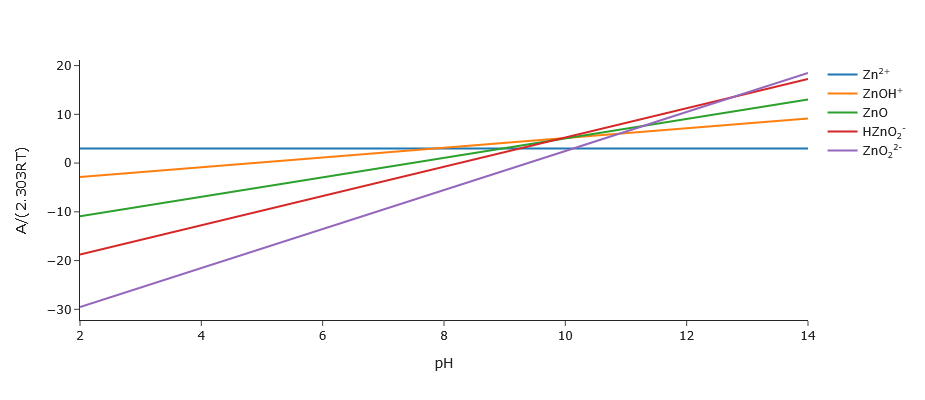

In [6]:
a = affinity(pH=[2, 14])
_ = diagram(a, width=500, height=400, interactive=True)

By default, the y-axis of our activity plot will be in unitless chemical affinity, $\text{A/(2.303RT)}$.

We can add the `alpha=True` parameter to plot mole fractions of our aqueous zinc species instead:

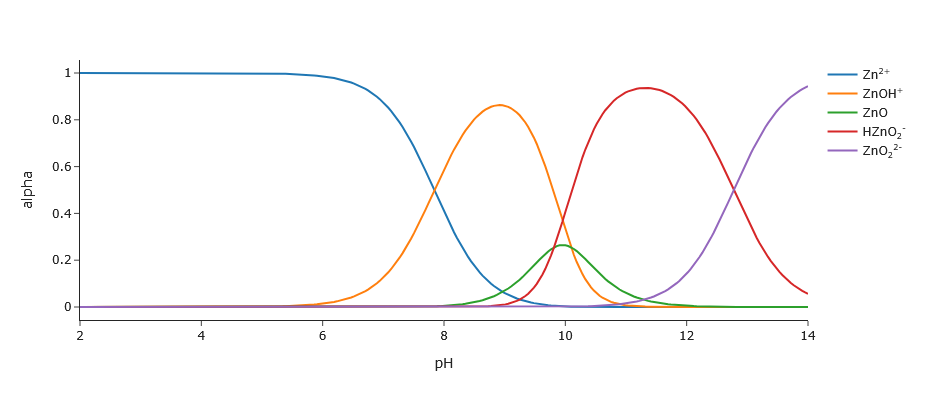

In [7]:
_ = diagram(a, alpha=True, width=500, height=400, interactive=True)

Let's pause and examine our diagram, mousing over the trends to see their corresponding pH and alpha values. What conclusions can we draw?

1) All of of these aqueous zinc species are predicted to be present at some abundance at every value of pH, even if it is a really, really small amount. For example, isolate the Zn+2 trend by double-clicking on it in the legend, then hover over the rightmost tip of the trendline at pH 14. The mole fraction of Zn+2 is quite small (~10<sup>-16</sup>) but it is still mathematically present under those conditions.
  
2) According to our activity diagram, Zn+2 is the predominant species below pH 7.8, and makes up >99% of our zinc species below pH 5.8.

3) The first hydroxide complex is predominant between pH 7.8 to 10.

4) Interestingly, the second hydroxide complex, ZnO, peaks at about pH 10 but is never predominant.

5) The third hydroxide complex, HZnO2-, is predominant between pH 10 to 12.8.

6) Finally, the fourth complex is predominant at pH 12.8 and higher.

Since we did not specify temperature, pressure, and ionic strength, those variables are set to default values of 25 °C, water liquid-vapor saturation pressure (Psat), and 0 mol/kg, respectively.

Let's change the temperature to 200 °C in the `affinity` function to see what happens:

affinity: temperature is 200 ºC
affinity: pressure is Psat
affinity: variable 1 is log10(a_H+) at 256 values from -2 to -14
subcrt: 8 species at 200 ºC and Psat (wet) [energy units: J]


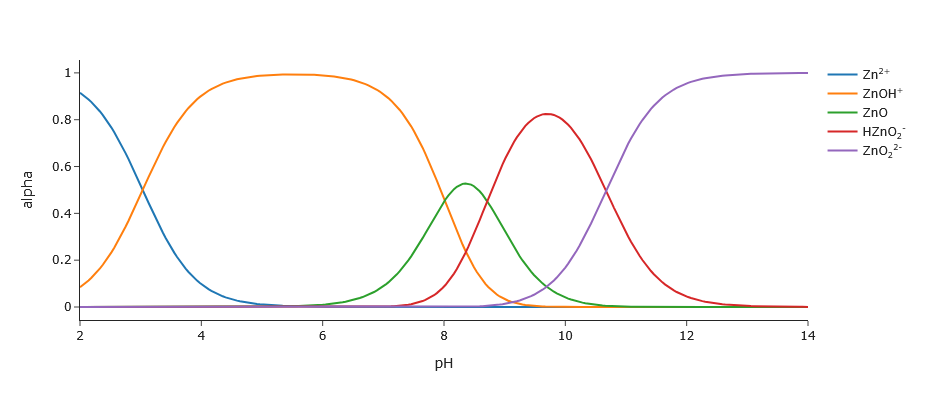

In [8]:
a = affinity(pH=[2, 14], T=200)
_ = diagram(a, alpha=True, width=500, height=400, interactive=True)

These new conditions have changed the thermodynamic landscape of our activity diagram a bit:
- The predominance regions of these aqueous zinc species has shifted to lower pH values and have changed their shapes.
- The second hydroxide complex, ZnO, now has a small pH range where it is predominant.

Since temperature seems to be an influential variable in aqueous zinc speciation, let's turn it into an axis on our diagram:

affinity: pressure is Psat
affinity: variable 2 is log10(a_H+) at 256 values from -2 to -14
subcrt: 8 species at 256 values of T (ºC) and Psat (wet) [energy units: J]


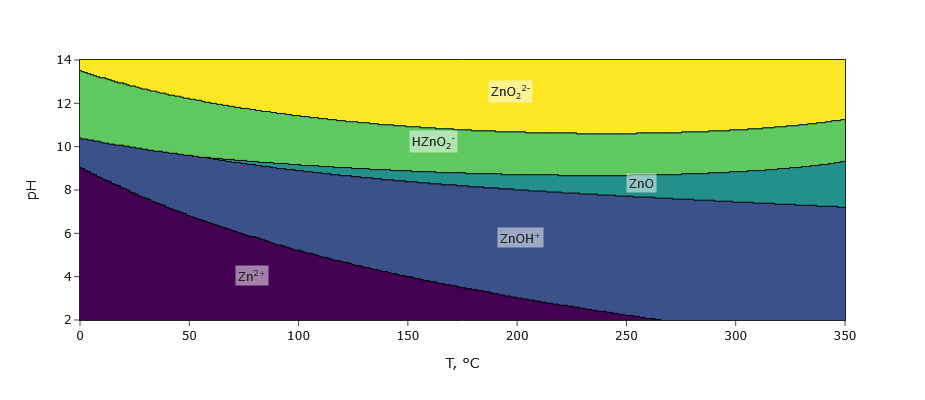

In [9]:
a = affinity(pH=[2, 14], T=[0, 350])
_ = diagram(a, width=500, height=400, interactive=True) # we don't need alpha=True for 2D predominance diagrams

The plot has changed from "1D" to "2D". Only the most predominant zinc species are shown in this pH-temperature space, but keep in mind that *all* zinc species are present in some amount everywhere.

Now let's bring in another element. If we add chlorine to our system, we will be able to plot both zinc hydroxide and chloride complexes. Let's add Cl- as a basis species:

In [10]:
basis(["Zn+2", "H2O", "H+", "O2(g)", "Cl-"])

info_character: found H2O(liq) [water]; also available in gas


,Cl,H,O,Z,Zn,ispecies,logact,state
Zn+2,0.0,0.0,0.0,2.0,1.0,633,0.0,aq
H2O,0.0,2.0,1.0,0.0,0.0,1,0.0,liq
H+,0.0,1.0,0.0,1.0,0.0,2,0.0,aq
O2,0.0,0.0,2.0,0.0,0.0,861,0.0,gas
Cl-,1.0,0.0,0.0,-1.0,0.0,29,0.0,aq


Our stoichiometric matrix now has five basis species providing five elements and charge. Perfect.

Note that the log activity of each of our species is 0 (see the logact column).

We can retrive a set of zinc hydroxide and chloride species with `retrieve`:

In [11]:
info(retrieve("Zn", ["O", "H", "Cl"], state="aq"))

,name,abbrv,formula,state,ref1,ref2,date,model,E_units,G,...,Cp,V,a1,a2,a3,a4,c1,c2,omega,Z
0,Zn+2,Zn+2,Zn+2,aq,SSWS97.5,SH88.1,11/7/1997,HKF,cal,-35200.0,...,-5.33,-24.30,-0.10676,-892.90,6.1282,-24098.0,18.7400,-53700.0,145740.0,2.0
1,ZnOH+,ZnOH+,ZnOH+1,aq,SSWS97.5,NaN,11/14/1997,HKF,cal,-81190.0,...,10.00,-5.30,0.11499,-496.77,7.6896,-25735.0,15.0306,-9975.0,32600.0,1.0
2,ZnO,ZnO,ZnO,aq,SSWS97.5,NaN,11/14/1997,HKF,cal,-67420.0,...,-10.00,-21.90,-0.12418,-1080.72,9.9819,-23321.0,0.0295,-50715.0,-3000.0,0.0
3,HZnO2-,HZnO2-,HZnO2-1,aq,SSWS97.5,NaN,11/14/1997,HKF,cal,-110720.0,...,20.00,-13.40,0.05623,-640.47,8.2588,-25141.0,35.0874,10394.0,186690.0,-1.0
4,ZnO2-2,ZnO2-2,ZnO2-2,aq,SSWS97.5,NaN,11/14/1997,HKF,cal,-93290.0,...,-15.00,-26.40,-0.05559,-913.47,9.3301,-24013.0,32.5837,-60900.0,382160.0,-2.0
5,ZnCl+,ZnCl+,ZnCl+,aq,SSH97.3,NaN,9/16/1997,HKF,cal,-66850.0,...,19.90,-1.28,0.16583,-372.93,7.2088,-26248.0,19.6947,10191.0,20250.0,1.0
6,ZnCl2,ZnCl2,ZnCl2,aq,SSH97.3,NaN,9/16/1997,HKF,cal,-98300.0,...,34.70,24.82,0.51486,479.29,3.8592,-29771.0,26.1528,40338.0,-3800.0,0.0
7,ZnCl3-,ZnCl3-,ZnCl3-,aq,SSH97.3,NaN,10/2/1997,HKF,cal,-129310.0,...,41.97,53.90,0.95636,1557.32,-0.3779,-34227.0,42.2912,55147.0,125130.0,-1.0


We'll pass these retrieved species to our `species` function:

In [12]:
species(retrieve("Zn", ["O", "H", "Cl"], state="aq"))

,Zn+2,H2O,H+,O2,Cl-,ispecies,logact,state,name
0,1.0,0.0,0.0,0.0,0.0,633,-3.0,aq,Zn+2
1,1.0,1.0,-1.0,0.0,0.0,634,-3.0,aq,ZnOH+
2,1.0,1.0,-2.0,0.0,0.0,635,-3.0,aq,ZnO
3,1.0,2.0,-3.0,0.0,0.0,636,-3.0,aq,HZnO2-
4,1.0,2.0,-4.0,0.0,0.0,637,-3.0,aq,ZnO2-2
5,1.0,0.0,0.0,0.0,1.0,638,-3.0,aq,ZnCl+
6,1.0,0.0,0.0,0.0,2.0,639,-3.0,aq,ZnCl2
7,1.0,0.0,0.0,0.0,3.0,640,-3.0,aq,ZnCl3-


Now let's plot our system:

affinity: pressure is Psat
affinity: variable 2 is log10(a_H+) at 256 values from -2 to -14
subcrt: 12 species at 256 values of T (ºC) and Psat (wet) [energy units: J]


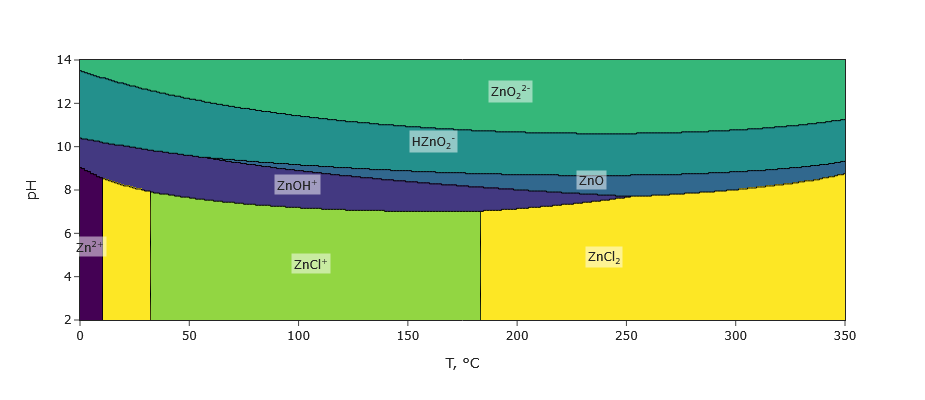

In [13]:
a = affinity(pH=[2, 14], T=[0, 350])
_ = diagram(a, width=500, height=400, interactive=True)

Zinc chloride complexes now appear in the diagram!

What can we take away from this?

- temperature affects zinc speciation.
- pH affects zinc speciation. Hydroxide complexes are favored at higher pH.

The fact that pH changes zinc speciation tells us something else too: fluid composition matters. What other things compose our fluid Zn+2 and Cl- are present... do you think changing the abundance of zinc or chloride will affect things?

Recall that our basis species are all set to a log activity of 0:

In [14]:
basis()

,Cl,H,O,Z,Zn,ispecies,logact,state
Zn+2,0.0,0.0,0.0,2.0,1.0,633,0.0,aq
H2O,0.0,2.0,1.0,0.0,0.0,1,0.0,liq
H+,0.0,1.0,0.0,1.0,0.0,2,0.0,aq
O2,0.0,0.0,2.0,0.0,0.0,861,0.0,gas
Cl-,1.0,0.0,0.0,-1.0,0.0,29,0.0,aq


If we decrease the log activity of chloride that is involved in the formation reactions of zinc chloride complexes, what do you think will happen to our predominance diagram? Let's lower the log activity of Cl- to -2 using `basis`:

In [15]:
basis("Cl-", -2)

,Cl,H,O,Z,Zn,ispecies,logact,state
Zn+2,0.0,0.0,0.0,2.0,1.0,633,0.0,aq
H2O,0.0,2.0,1.0,0.0,0.0,1,0.0,liq
H+,0.0,1.0,0.0,1.0,0.0,2,0.0,aq
O2,0.0,0.0,2.0,0.0,0.0,861,0.0,gas
Cl-,1.0,0.0,0.0,-1.0,0.0,29,-2.0,aq


Note the -2.0 in the `logact` column of the basis species table above indicating that we successfully changed the log activity of Cl-.

Now let's recreate the diagram to see if anything has changed:

affinity: pressure is Psat
affinity: variable 2 is log10(a_H+) at 256 values from -2 to -14
subcrt: 12 species at 256 values of T (ºC) and Psat (wet) [energy units: J]


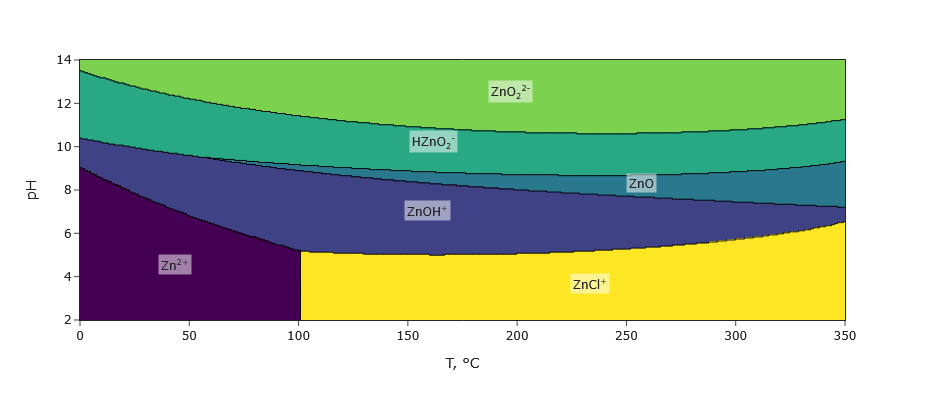

In [16]:
a = affinity(pH=[2, 14], T=[0, 350])
_ = diagram(a, width=500, height=400, interactive=True)

The diagram looks different! There is less Cl- present in our system to drive the formation of zinc chloride complexes. The first zinc chloride complex, ZnCl+ still has a predominance region, but the second complex is now absent in this pH-temperature space. Further, the hydroxide complexes and free Zn+2 ion are generally more predominant.

What do you think will happen if we change the log activity of zinc in our system? Let's try lowering its activity by a lot:

In [17]:
basis("Zn+2", -15)

,Cl,H,O,Z,Zn,ispecies,logact,state
Zn+2,0.0,0.0,0.0,2.0,1.0,633,-15.0,aq
H2O,0.0,2.0,1.0,0.0,0.0,1,0.0,liq
H+,0.0,1.0,0.0,1.0,0.0,2,0.0,aq
O2,0.0,0.0,2.0,0.0,0.0,861,0.0,gas
Cl-,1.0,0.0,0.0,-1.0,0.0,29,-2.0,aq


Let's remake the diagram.

affinity: pressure is Psat
affinity: variable 2 is log10(a_H+) at 256 values from -2 to -14
subcrt: 12 species at 256 values of T (ºC) and Psat (wet) [energy units: J]


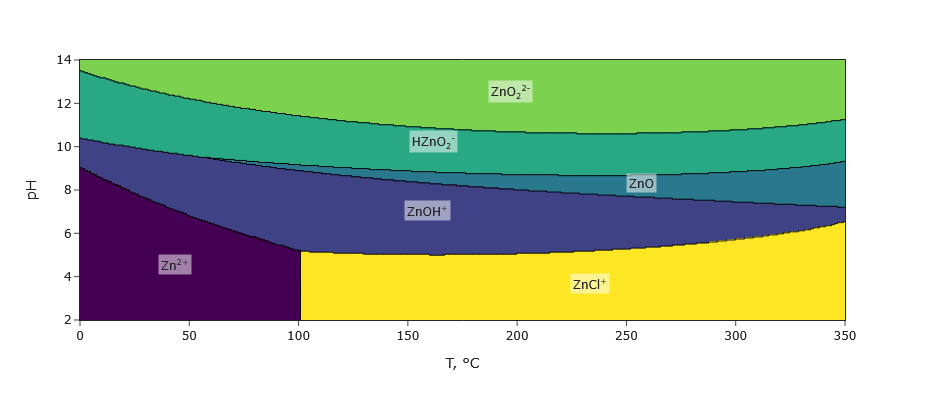

In [18]:
a = affinity(pH=[2, 14], T=[0, 350])
_ = diagram(a, width=500, height=400, interactive=True)

Did anything change this time?

No. But why?

Every one of these zinc species has one Zn+2 involved in its formation reaction, so changing the abundance of zinc has no effect on the predicted ratios of zinc species formed.

Hypothetically, if we were plotting a set of zinc species containing variable numbers of Zn in their formulae, then changing the activity of Zn+2 in our system might alter our diagram. However, this depends on our *balancing constraints*; a topic we will cover in the next demo.

For now, let's explore this system some more and make Cl- an axis variable that ranges from a log activity of -1 to 2. How do we do this?

Normally, we would simply change one of the parameters in `affinity` to indicate the range that we'd like to plot. For Cl-, it would make sense for it to look something like this.

```
a = affinity(pH = [2, 14], Cl- = [-1, 2])
```

Inputting it this way will result in a Python error because function parameters can't be written with + or - symbols. Since Cl- has one of these symbols to denote charge, we can't input the parameter directly this way.

Instead, we need to define our function parameters in a *Python dictionary* with curly braces, `{}`, and key-value pairs denoted by colons, `:`, separated by commas. Let's assign a dictionary of our `affinity` parameters to a variable with an arbitrary name, `my_affinity_params`:

In [19]:
my_affinity_params = {"pH":[2, 14], "Cl-":[-1, 2]}
my_affinity_params

{'pH': [2, 14], 'Cl-': [-1, 2]}

Dictionaries are handy because they let us pull out stored values when we call upon its associated key. For example, we can grab our desired range of Fe+2 log activities that we wish to plot:

In [20]:
# using "Cl-" as a key to pull its value from the dictionary
my_affinity_params["Cl-"]

[-1, 2]

Python accepts dictionaries to assign function parameters using double asterisks, `**`, before the dictionary. This lets us assign parameters that contain + and - symbols like our Cl- axis:

In [21]:
a = affinity(**my_affinity_params)

affinity: temperature is 25 ºC
affinity: pressure is Psat
affinity: variable 1 is log10(a_H+) at 256 values from -2 to -14
affinity: variable 2 is log10(a_Cl-) at 256 values from -1 to 2
subcrt: 12 species at 25 ºC and Psat (wet) [energy units: J]


It is also possible to feed the dictionary directly into a function using double asterisks:

In [22]:
a = affinity(**{"pH":[2, 14], "Cl-":[-1, 2]})

affinity: temperature is 25 ºC
affinity: pressure is Psat
affinity: variable 1 is log10(a_H+) at 256 values from -2 to -14
affinity: variable 2 is log10(a_Cl-) at 256 values from -1 to 2
subcrt: 12 species at 25 ºC and Psat (wet) [energy units: J]


Okay, let's plot the output of our `affinity` calculation using `diagram`.

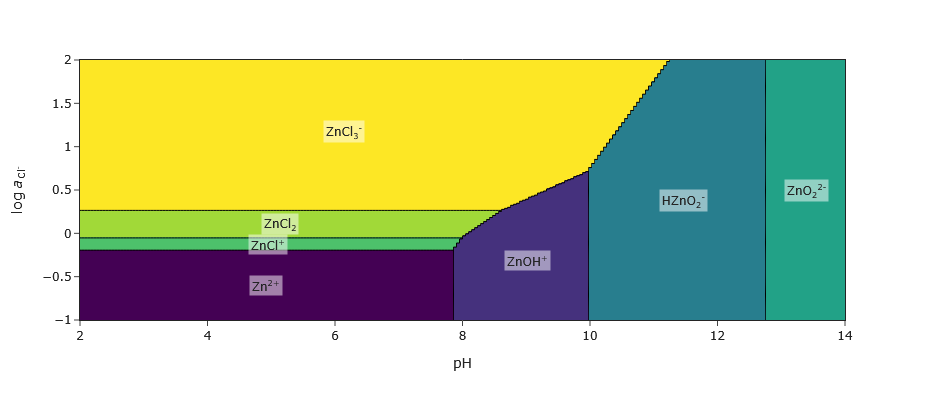

In [23]:
_ = diagram(a, width=500, height=400, interactive=True)

From our new diagram, we can see that:
- Higher pH values still tend to favor the formation of zinc hydroxide complexes.
- Increasing chloride activity at lower pH values tends to drive the formation of zinc chloride complexes.

Note that whenever we specify a range for an axis, that range overrides the static value set by `basis`. In other words, we previously adjusted Cl- in our basis species set to have a log activity of -2. That constraint has been overwritten in order to plot a range of Cl- log activities. It's the same story with pH; the log activity of H+ in our basis set is 0. Since pH is an axis, the log activity of H+ is allowed to change.

What happens at higher temperatures and pressures? Let's add some parameters to our `affinity` function too see what the system looks like at 300 °C and 2 kb:

affinity: temperature is 300 ºC
affinity: pressure is 2000 bar
affinity: variable 1 is log10(a_H+) at 256 values from -2 to -14
affinity: variable 2 is log10(a_Cl-) at 256 values from -1 to 2
subcrt: 12 species at 300 ºC and 2000.00 bar (wet) [energy units: J]


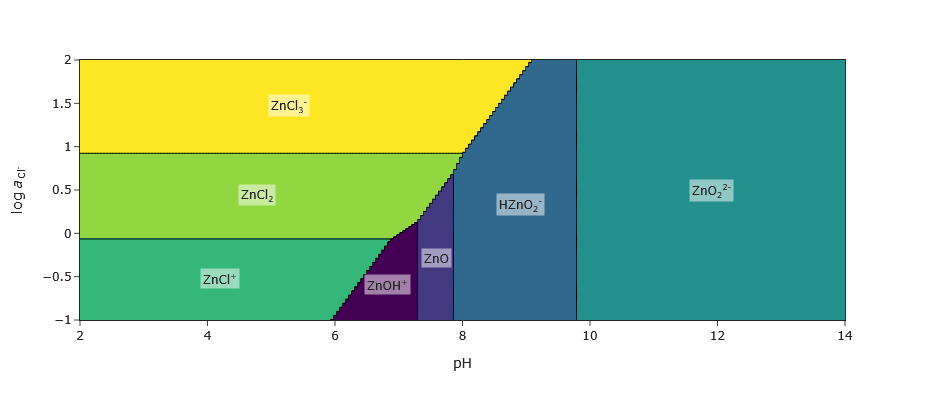

In [24]:
a = affinity(**{"pH":[2, 14], "Cl-":[-1, 2], "T":300, "P":2000})
_ = diagram(a, width=500, height=400, interactive=True)

Interesting! Free Zn+2 is no longer predominant in this pH-chloride space; zinc complexes have taken over. Additionally, predominance regions for zinc complexes have shifted, expanded, or shrunk.

Let's put it all together into one cell:

The WORM thermodynamic database has been loaded: 1713 aqueous, 1976 total species
info_character: found H2O(liq) [water]; also available in gas
affinity: temperature is 300 ºC
affinity: pressure is 2000 bar
affinity: variable 1 is log10(a_H+) at 256 values from -2 to -14
affinity: variable 2 is log10(a_Cl-) at 256 values from -1 to 2
subcrt: 12 species at 300 ºC and 2000.00 bar (wet) [energy units: J]


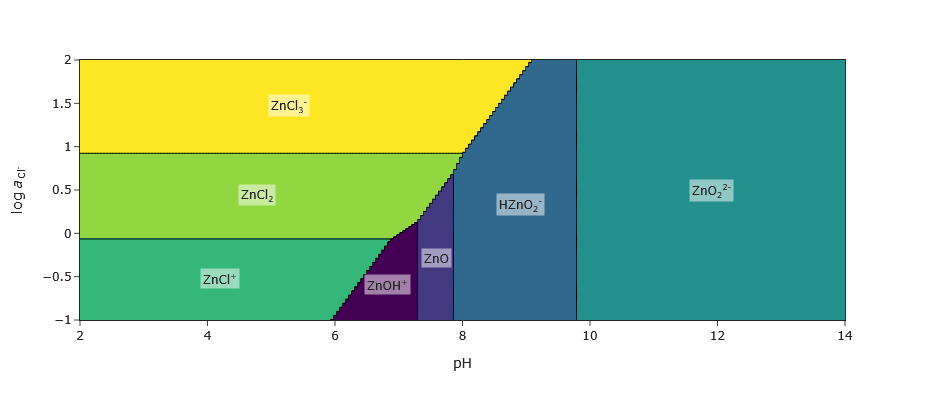

In [25]:
from pychnosz import *
_ = thermo("WORM")

basis(["Zn+2", "H2O", "H+", "O2(g)", "Cl-"])
species(retrieve("Zn", ["O", "H", "Cl"], state="aq"))
a = affinity(**{"pH":[2, 14], "Cl-":[-1, 2], "T":300, "P":2000})
_ = diagram(a, width=500, height=400, interactive=True)

End of demo.